In [1]:
import kagglehub
from kagglehub import KaggleDatasetAdapter
import sys
import os
import pandas as pd
import backtrader as bt
import matplotlib

b:\Projects\portfolio_management\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Download latest version
path = kagglehub.dataset_download("khalilvandian/portfolio-management")

# List all files and directories in the downloaded dataset path
files = os.listdir(path)
print("Files in dataset directory:", files)

Files in dataset directory: ['AVGO.csv', 'AXP.csv', 'BAC.csv', 'CB.csv', 'CMG.csv', 'EA.csv', 'EBAY.csv', 'GRMN.csv', 'IBM.csv', 'IT.csv', 'LEG.csv', 'MHK.csv', 'MS.csv', 'ORLY.csv', 'XL.csv']


In [3]:
def clean_stock_data(filepath):
    df = pd.read_csv(filepath)

    # Standardize column names (lowercase, no special characters)
    df.columns = [col.strip().lower().replace('/', '_').replace(' ', '_') for col in df.columns]

    # Rename 'close/last' to 'close' if needed
    if 'close_last' in df.columns:
        df.rename(columns={'close_last': 'close'}, inplace=True)

    # Remove dollar signs and convert to float
    df['close'] = df['close'].replace('[\\$,]', '', regex=True).astype(float)
    df['open'] = df['open'].replace('[\\$,]', '', regex=True).astype(float)
    df['high'] = df['high'].replace('[\\$,]', '', regex=True).astype(float)
    df['low'] = df['low'].replace('[\\$,]', '', regex=True).astype(float)

    # Parse dates
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)
    df.sort_index(inplace=True)

    return df

In [4]:
stock_data_dict = {}
full_date_index = pd.date_range(start="2015-06-16", end="2025-06-13", freq='B')

for file in files: 
    ticker_name = file.replace(".csv", "").strip()
    file_path = os.path.join(path, file)

    stock_df = clean_stock_data(file_path)
    stock_df = stock_df.reindex(full_date_index)
    stock_df.ffill(inplace=True) 
    stock_df.fillna(0, inplace=True)

    stock_data_dict[ticker_name] = stock_df


# Add no risk option
# copy 1st df and change all values to a constant value
no_risk = stock_data_dict["AVGO"].copy()
no_risk["close"] = 1
no_risk["open"] = 1
no_risk["high"] = 1
no_risk["low"] = 1
no_risk["volume"] = 0
stock_data_dict["NoRisk"] = no_risk

tickers = list(stock_data_dict.keys())
print(tickers)

['AVGO', 'AXP', 'BAC', 'CB', 'CMG', 'EA', 'EBAY', 'GRMN', 'IBM', 'IT', 'LEG', 'MHK', 'MS', 'ORLY', 'XL', 'NoRisk']


In [5]:
no_risk

,close,volume,open,high,low
2015-06-16,1,0,1,1,1
2015-06-17,1,0,1,1,1
2015-06-18,1,0,1,1,1
2015-06-19,1,0,1,1,1
2015-06-22,1,0,1,1,1
...,...,...,...,...,...
2025-06-09,1,0,1,1,1
2025-06-10,1,0,1,1,1
2025-06-11,1,0,1,1,1
2025-06-12,1,0,1,1,1


In [6]:
# Find and print tickers with any NaN in their "close" column
for ticker, df in stock_data_dict.items():
	if df["close"].isna().any():
		print(f"{ticker} has NaN values in 'close':")
		print(df[df["close"].isna()])

# Data Project - Stock Market Analysis 

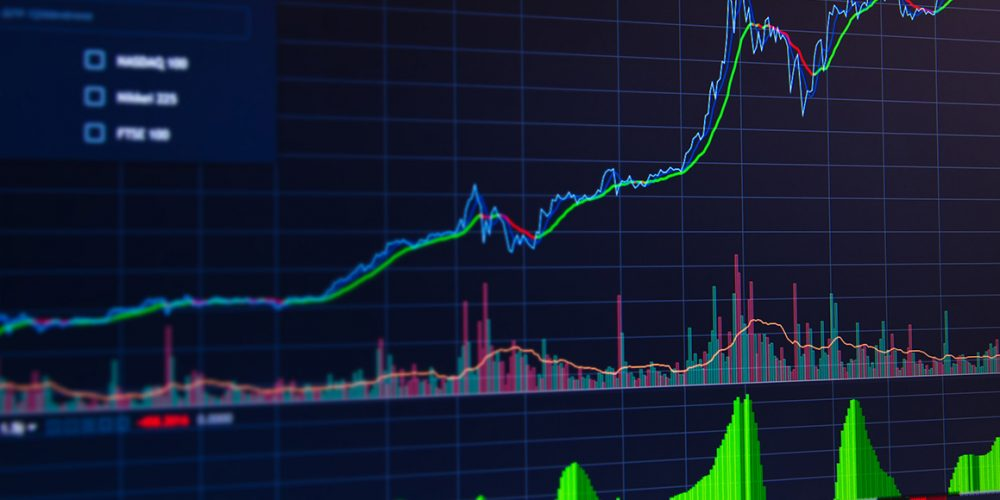

Time Series data is a series of data points indexed in time order. Time series data is everywhere, so manipulating them is important for any data analyst or data scientist.

In this notebook, we will discover and explore data from the stock market, particularly some technology stocks (Apple, Amazon, Google, and Microsoft). We will learn how to use yfinance to get stock information, and visualize different aspects of it using Seaborn and Matplotlib. we will look at a few ways of analyzing the risk of a stock, based on its previous performance history. We will also be predicting future stock prices through a Long Short Term Memory (LSTM) method!

We'll be answering the following questions along the way:

    1.) What was the change in price of the stock over time?
    2.) What was the daily return of the stock on average?
    3.) What was the moving average of the various stocks?
    4.) What was the correlation between different stocks'?
    5.) How much value do we put at risk by investing in a particular stock?
    6.) How can we attempt to predict future stock behavior? (Predicting the closing price stock price of APPLE inc using LSTM)

***   

## Getting the Data
The first step is to get the data and load it to memory. We will get our stock data from the Yahoo Finance website. Yahoo Finance is a rich resource of financial market data and tools to find compelling investments. To get the data from Yahoo Finance, we will be using yfinance library which offers a threaded and Pythonic way to download market data from Yahoo. Check this article to learn more about yfinance: [Reliably download historical market data from with Python](https://aroussi.com/post/python-yahoo-finance)

# 1. What was the change in price of the stock overtime?

In this section we'll go over how to handle requesting stock information with pandas, and how to analyze basic attributes of a stock.

In [8]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
plt.style.use("fivethirtyeight")
%matplotlib inline

# For reading stock data from yahoo
from pandas_datareader.data import DataReader
import yfinance as yf
from pandas_datareader import data as pdr

yf.pdr_override()

# For time stamps
from datetime import datetime


# The tech stocks we'll use for this analysis
tech_list = ['AAPL', 'GOOG', 'MSFT', 'AMZN']

# Set up End and Start times for data grab
tech_list = ['AAPL', 'GOOG', 'MSFT', 'AMZN']

end = datetime.now()
start = datetime(end.year - 1, end.month, end.day)

for stock in tech_list:
    globals()[stock] = yf.download(stock, start, end)
    

company_list = [AAPL, GOOG, MSFT, AMZN]
company_name = ["APPLE", "GOOGLE", "MICROSOFT", "AMAZON"]

for company, com_name in zip(company_list, company_name):
    company["company_name"] = com_name
    
df = pd.concat(company_list, axis=0)
df.tail(10)

AttributeError: module 'yfinance' has no attribute 'pdr_override'

Reviewing the content of our data, we can see that the data is numeric and the date is the index of the data. Notice also that weekends are missing from the records.

**Quick note:** Using `globals()` is a sloppy way of setting the `DataFrame` names, but it's simple. Now we have our data, let's perform some basic data analysis and check our data.

## Descriptive Statistics about the Data
`.describe()` generates descriptive statistics. Descriptive statistics include those that summarize the central tendency, dispersion, and shape of a dataset’s distribution, excluding `NaN` values.

Analyzes both numeric and object series, as well as `DataFrame` column sets of mixed data types. The output will vary depending on what is provided. Refer to the notes below for more detail.

In [20]:
print(f"Stats for the company {tickers[5]} \n")

EA = stock_data_dict[tickers[5]]
EA.describe().round(2)

Stats for the company EA 



,close,volume,open,high,low
count,2609.00,2609.00,2609.00,2609.00,2609.00
mean,114.89,3022023.53,114.88,116.16,113.56
std,25.14,2147819.13,25.16,25.31,24.99
min,55.50,583933.00,54.39,56.57,53.01
25%,94.47,1852324.00,94.44,95.87,92.98
50%,121.50,2498714.00,121.43,123.00,120.21
75%,135.11,3514937.00,134.94,136.59,133.54
max,167.97,38356770.00,168.46,168.50,166.93


## Information About the Data
`.info()` method prints information about a DataFrame including the index `dtype` and columns, non-null values, and memory usage.

In [21]:
# General info
EA.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2609 entries, 2015-06-16 to 2025-06-13
Freq: B
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   close   2609 non-null   float64
 1   volume  2609 non-null   float64
 2   open    2609 non-null   float64
 3   high    2609 non-null   float64
 4   low     2609 non-null   float64
dtypes: float64(5)
memory usage: 122.3 KB


## Closing Price

The closing price is the last price at which the stock is traded during the regular trading day. A stock’s closing price is the standard benchmark used by investors to track its performance over time.

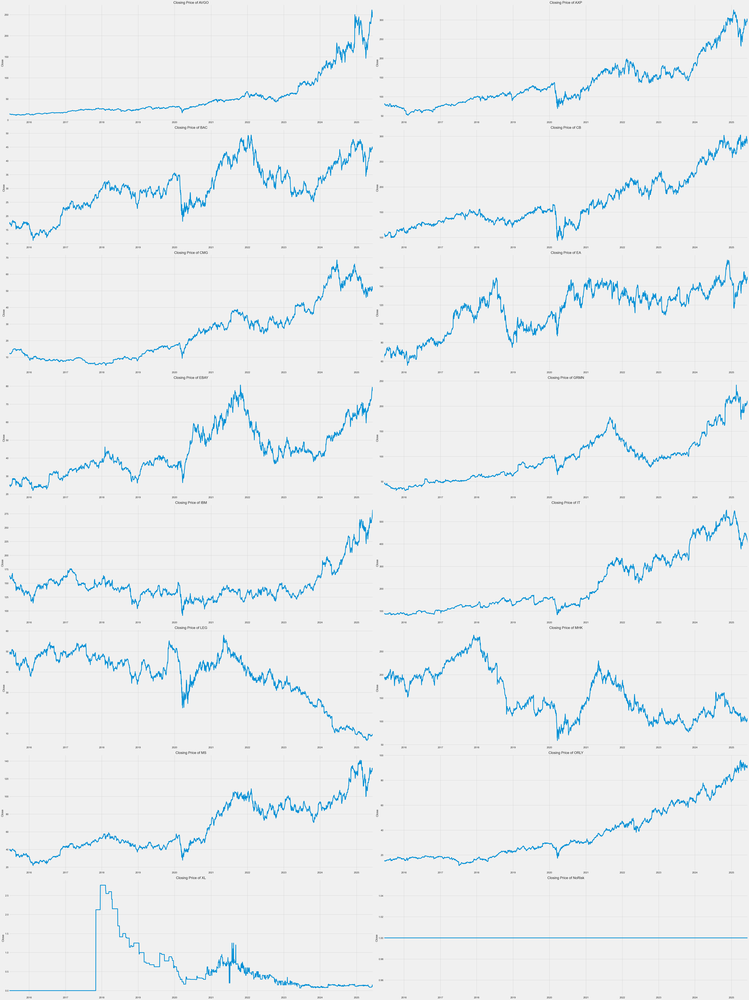

In [36]:
# Let's see a historical view of the closing price
plt.figure(figsize=(60, 80))
plt.subplots_adjust(top=1.25, bottom=1.2)

for i, company in enumerate(tickers, 1):
    plt.subplot(8, 2, i)
    stock_data_dict[company]['close'].plot()
    plt.ylabel('Close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {company}")
    
plt.tight_layout()

## Volume of Sales
Volume is the amount of an asset or security that changes hands over some period of time, often over the course of a day. For instance, the stock trading volume would refer to the number of shares of security traded between its daily open and close. Trading volume, and changes to volume over the course of time, are important inputs for technical traders.

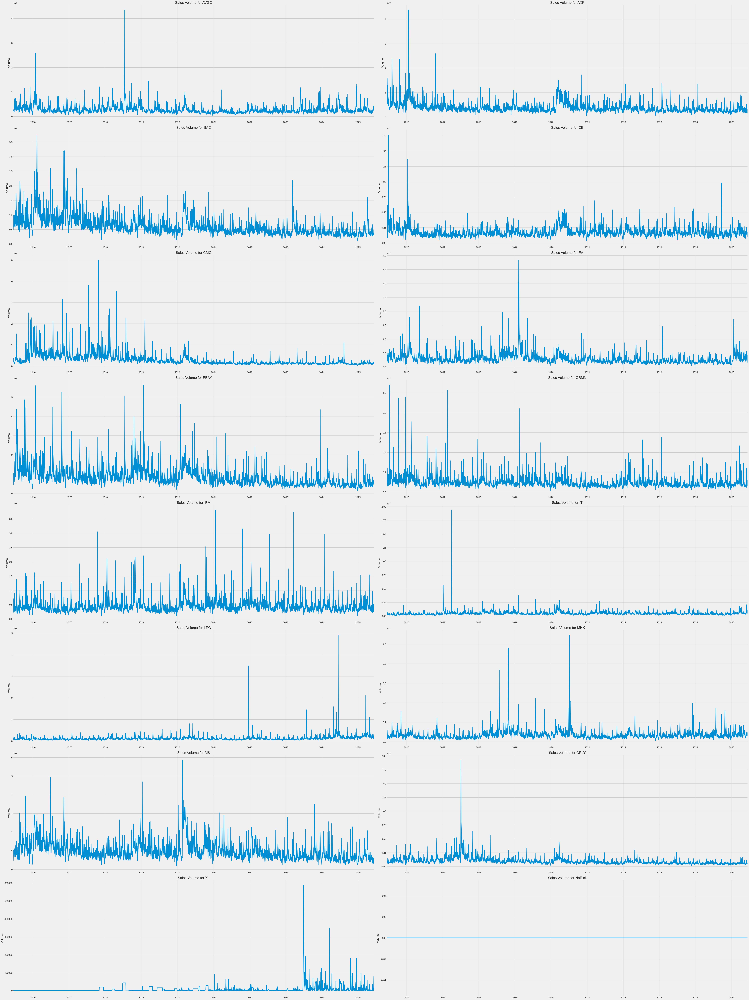

In [38]:
# Now let's plot the total volume of stock being traded each day
plt.figure(figsize=(60, 80))
plt.subplots_adjust(top=1.25, bottom=1.2)

for i, company in enumerate(tickers, 1):
    plt.subplot(8, 2, i)
    stock_data_dict[company]['volume'].plot()
    plt.ylabel('Volume')
    plt.xlabel(None)
    plt.title(f"Sales Volume for {company}")
    
plt.tight_layout()

Now that we've seen the visualizations for the closing price and the volume traded each day, let's go ahead and caculate the moving average for the stock.

# 2. What was the moving average of the various stocks?

The moving average (MA) is a simple technical analysis tool that smooths out price data by creating a constantly updated average price. The average is taken over a specific period of time, like 10 days, 20 minutes, 30 weeks, or any time period the trader chooses.

In [52]:
ma_day = [10, 20, 50]

for ma in ma_day:
    for company in tickers:
        column_name = f"MA for {ma} days"
        stock_data_dict[company][column_name] = stock_data_dict[company]['close'].rolling(ma).mean()
        

fig, axes = plt.subplots(nrows=8, ncols=2)
fig.set_figheight(100)
fig.set_figwidth(100)

for idx, (company, df) in enumerate(stock_data_dict.items()):
    i = idx // 2
    j = idx % 2
    df[['close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(ax=axes[i,j])
    axes[i,j].set_title(company)

fig.tight_layout()

We see in the graph that the best values to measure the moving average are 10 and 20 days because we still capture trends in the data without noise.

# 3. What was the daily return of the stock on average?

Now that we've done some baseline analysis, let's go ahead and dive a little deeper. We're now going to analyze the risk of the stock. In order to do so we'll need to take a closer look at the daily changes of the stock, and not just its absolute value. Let's go ahead and use pandas to retrieve teh daily returns for the Apple stock.

In [56]:
company_list = stock_data_dict.values()

In [57]:
# We'll use pct_change to find the percent change for each day
for company in tickers:
    stock_data_dict[company]['Daily Return'] = stock_data_dict[company]['close'].pct_change()

# Then we'll plot the daily return percentage
fig, axes = plt.subplots(nrows=8, ncols=2)
fig.set_figheight(100)
fig.set_figwidth(100)

for idx, (company, df) in enumerate(stock_data_dict.items()):
    i = idx // 2
    j = idx % 2
    df['Daily Return'].plot(ax=axes[i,j], legend=True, linestyle='--', marker='o')
    axes[i,j].set_title(company)

fig.tight_layout()

Great, now let's get an overall look at the average daily return using a histogram. We'll use seaborn to create both a histogram and kde plot on the same figure.

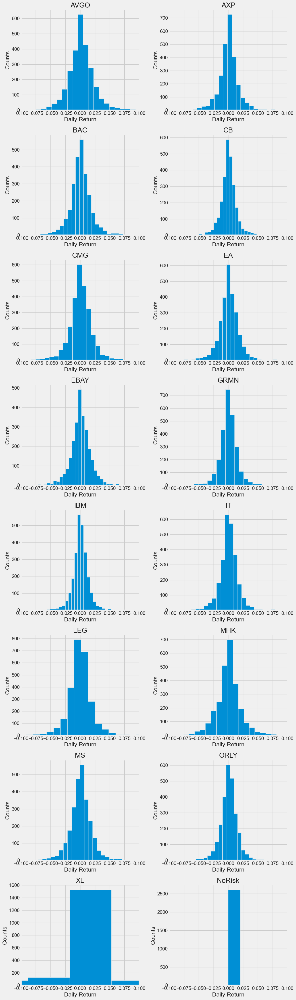

In [63]:
# Step 1: Compute global min and max across all daily returns
all_returns = []

for company in tickers:
    data = stock_data_dict[company]['Daily Return'].replace([np.inf, -np.inf], np.nan).dropna()
    all_returns.extend(data.tolist())

global_min = np.min(all_returns)
global_max = np.max(all_returns)

# Step 2: Plot histograms with shared x-axis
plt.figure(figsize=(12, 40))

for i, company in enumerate(tickers, 1):
    plt.subplot(8, 2, i)
    data = stock_data_dict[company]['Daily Return'].replace([np.inf, -np.inf], np.nan).dropna()
    plt.hist(data, bins=50)
    plt.xlim(-0.1, 0.1)  # <- Share the same x-axis
    plt.xlabel('Daily Return')
    plt.ylabel('Counts')
    plt.title(f'{company}')

plt.tight_layout()
plt.show()

# 4. What was the correlation between different stocks closing prices?

Correlation is a statistic that measures the degree to which two variables move in relation to each other which has a value that must fall between -1.0 and +1.0. Correlation measures association, but doesn’t show if x causes y or vice versa — or if the association is caused by a third factor[1].

Now what if we wanted to analyze the returns of all the stocks in our list? Let's go ahead and build a DataFrame with all the ['Close'] columns for each of the stocks dataframes.

In [76]:
# Grab all the closing prices for the tech stock list into one DataFrame
tech_rets = {}
for company, df in stock_data_dict.items():
    tech_rets[company] = df["close"]

index = tech_rets["AVGO"].index

# Make a new tech returns DataFrame
tech_rets = pd.DataFrame(data=tech_rets, index=index)
tech_rets.head()

,AVGO,AXP,BAC,CB,CMG,EA,EBAY,GRMN,IBM,IT,LEG,MHK,MS,ORLY,XL,NoRisk
2015-06-16,14.1990,79.36,17.55,106.28,12.0124,62.86,24.5494,45.260,161.4856,87.53,48.22,191.08,39.74,15.0573,0.0,1
2015-06-17,14.0685,80.32,17.37,106.33,12.1368,64.48,24.5616,45.220,161.8050,87.71,48.46,192.39,39.58,15.0813,0.0,1
2015-06-18,14.3000,80.77,17.38,107.66,12.1240,65.27,24.6184,46.560,162.8503,88.05,48.98,191.65,39.79,15.2907,0.0,1
2015-06-19,14.2890,80.19,17.17,106.01,12.3062,65.95,24.8131,46.845,161.6308,87.78,49.09,192.78,39.37,15.2967,0.0,1
2015-06-22,14.3275,81.25,17.47,106.13,12.3850,66.62,25.0484,47.020,162.3470,88.36,49.52,194.34,39.85,15.3760,0.0,1


Now we can compare the daily percentage return of two stocks to check how correlated. First let's see a sotck compared to itself.

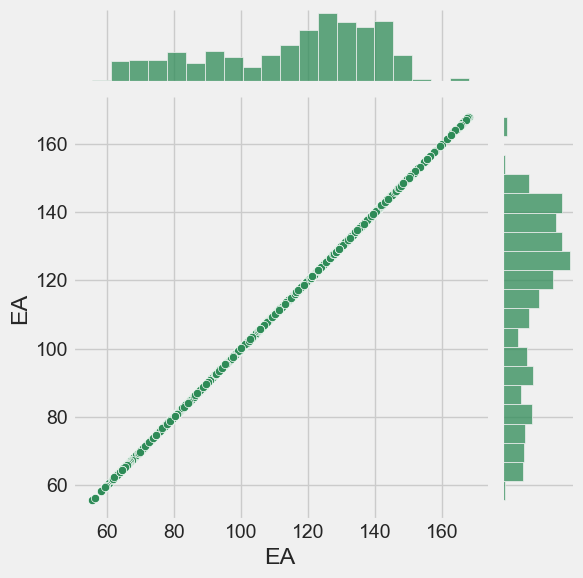

In [ ]:
sns.jointplot(x='EA', y='EA', data=tech_rets, kind='scatter', color='seagreen')

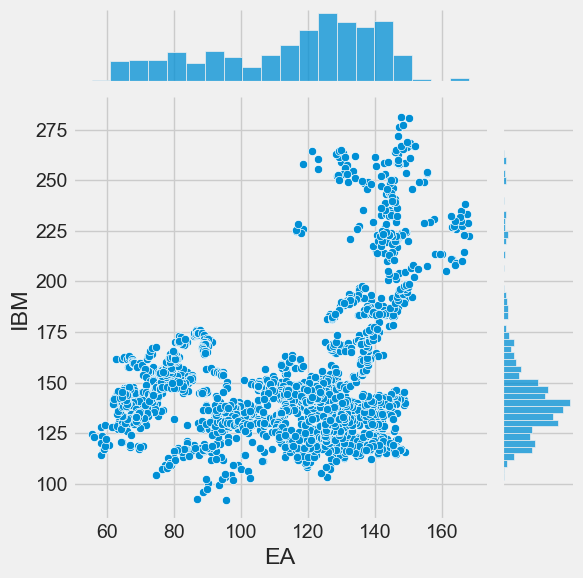

In [78]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='EA', y='IBM', data=tech_rets, kind='scatter')

So now we can see that if two stocks are perfectly (and positivley) correlated with each other a linear relationship bewteen its daily return values should occur. 

Seaborn and pandas make it very easy to repeat this comparison analysis for every possible combination of stocks in our technology stock ticker list. We can use sns.pairplot() to automatically create this plot

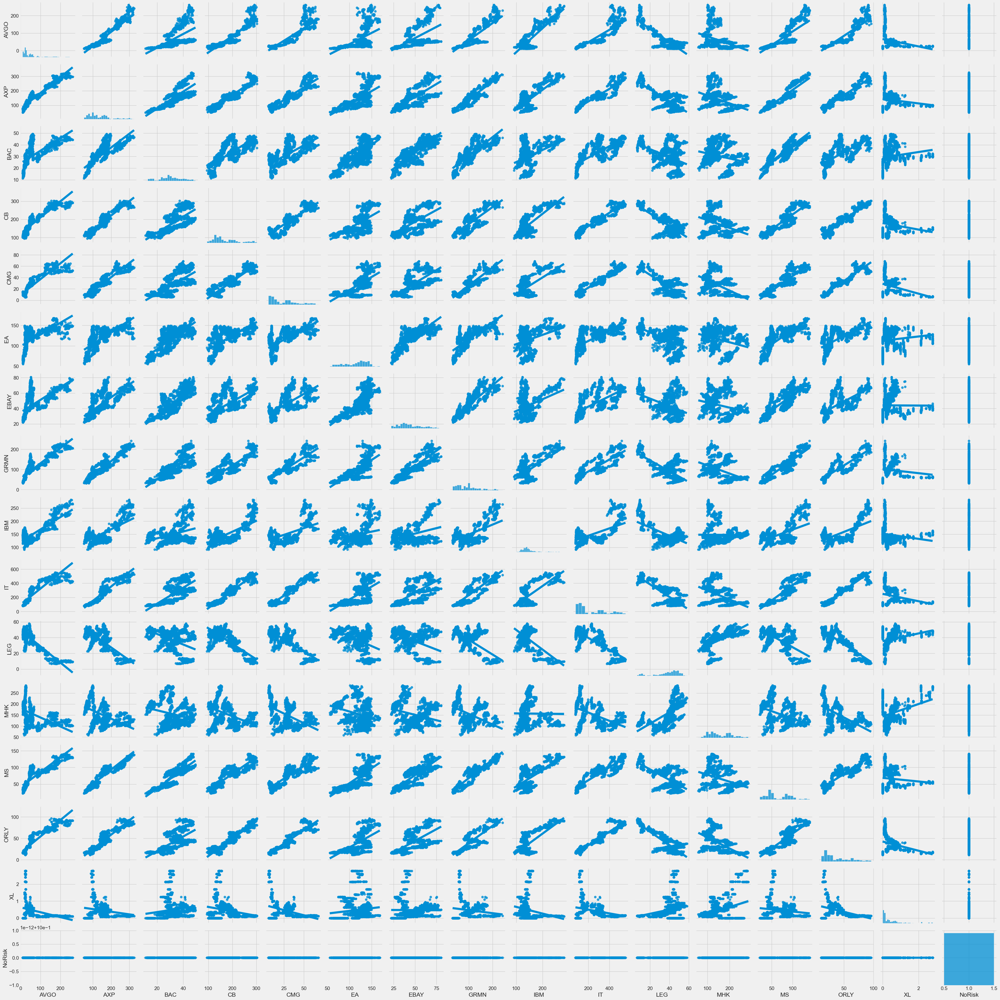

In [79]:
# We can simply call pairplot on our DataFrame for an automatic visual analysis 
# of all the comparisons

sns.pairplot(tech_rets, kind='reg')

b:\Projects\portfolio_management\.venv\Lib\site-packages\seaborn\axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
b:\Projects\portfolio_management\.venv\Lib\site-packages\seaborn\axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
b:\Projects\portfolio_management\.venv\Lib\site-packages\seaborn\axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
b:\Projects\portfolio_management\.venv\Lib\site-packages\seaborn\axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
b:\Projects\portfolio_management\.venv\Lib\site-packages\sea

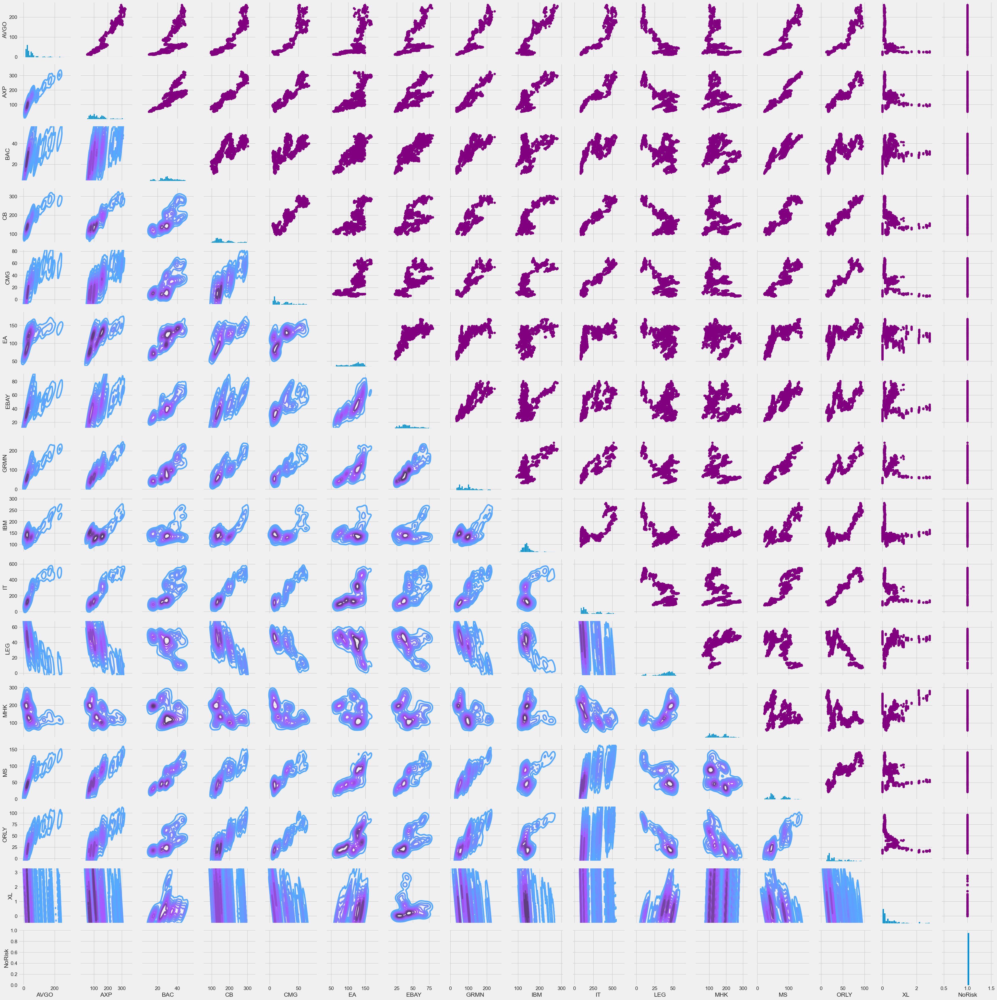

In [80]:
# Set up our figure by naming it returns_fig, call PairPLot on the DataFrame
return_fig = sns.PairGrid(tech_rets.dropna())

# Using map_upper we can specify what the upper triangle will look like.
return_fig.map_upper(plt.scatter, color='purple')

# We can also define the lower triangle in the figure, inclufing the plot type (kde) 
# or the color map (BluePurple)
return_fig.map_lower(sns.kdeplot, cmap='cool_d')

# Finally we'll define the diagonal as a series of histogram plots of the daily return
return_fig.map_diag(plt.hist, bins=30)

In [ ]:
# Set up our figure by naming it returns_fig, call PairPLot on the DataFrame
returns_fig = sns.PairGrid(tech_rets)

# Using map_upper we can specify what the upper triangle will look like.
returns_fig.map_upper(plt.scatter,color='purple')

# We can also define the lower triangle in the figure, inclufing the plot type (kde) or the color map (BluePurple)
returns_fig.map_lower(sns.kdeplot,cmap='cool_d')

# Finally we'll define the diagonal as a series of histogram plots of the daily return
returns_fig.map_diag(plt.hist,bins=30)

NameError: name 'closing_df' is not defined

Finally, we could also do a correlation plot, to get actual numerical values for the correlation between the stocks' daily return values. By comparing the closing prices, we see an interesting relationship between Microsoft and Apple.

Text(0.5, 1.0, 'Correlation of stock closing price')

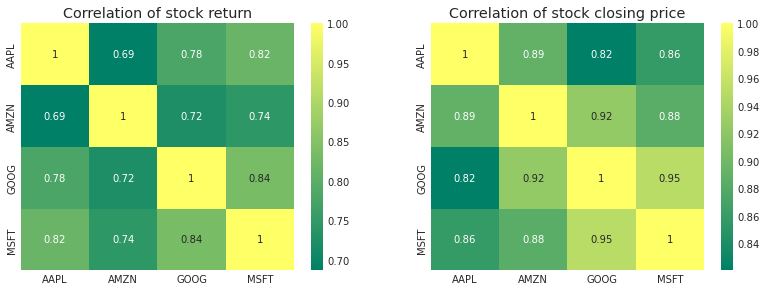

In [ ]:
plt.figure(figsize=(50, 50))

plt.subplot(4, 4, 1)
sns.heatmap(tech_rets.corr(), annot=True, cmap='summer')
plt.title('Correlation of stock return')

plt.subplot(4, 4, 2)
sns.heatmap(closing_df.corr(), annot=True, cmap='summer')
plt.title('Correlation of stock closing price')

Just like we suspected in our `PairPlot` we see here numerically and visually that Microsoft and Amazon had the strongest correlation of daily stock return. It's also interesting to see that all the technology comapnies are positively correlated.

# 5. How much value do we put at risk by investing in a particular stock?

There are many ways we can quantify risk, one of the most basic ways using the information we've gathered on daily percentage returns is by comparing the expected return with the standard deviation of the daily returns.

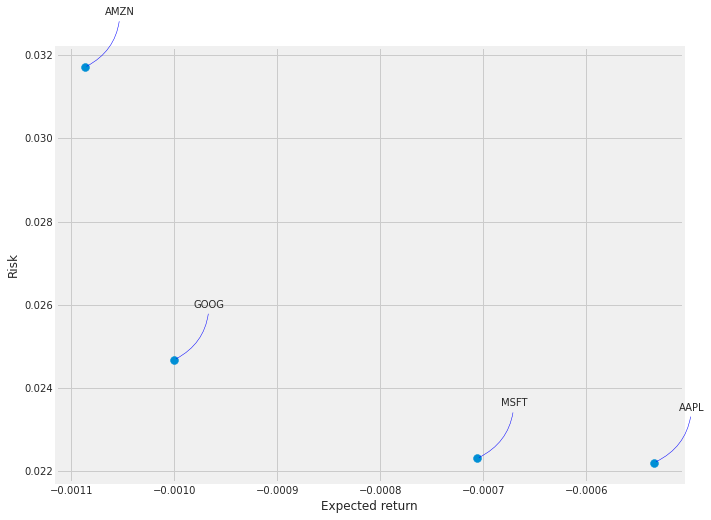

In [ ]:
rets = tech_rets.dropna()

area = np.pi * 20

plt.figure(figsize=(10, 8))
plt.scatter(rets.mean(), rets.std(), s=area)
plt.xlabel('Expected return')
plt.ylabel('Risk')

for label, x, y in zip(rets.columns, rets.mean(), rets.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom', 
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))